#Installing 

In [2]:
!pip install fsspec
!pip install gcsfs
!pip install -U tensorflow-addons

     |████████████████████████████████| 122kB 6.9MB/s 
     |████████████████████████████████| 1.3MB 7.8MB/s 
     |████████████████████████████████| 143kB 38.0MB/s 
     |████████████████████████████████| 296kB 36.3MB/s 
     |████████████████████████████████| 686kB 5.0MB/s 


In [3]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
import numpy as np

try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

Device: grpc://10.127.28.242:8470
INFO:tensorflow:Initializing the TPU system: grpc://10.127.28.242:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.127.28.242:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


Number of replicas: 8
2.5.0


###Check TPU provided

In [4]:
import os
from tensorflow.python.profiler import profiler_client

tpu_profile_service_address = os.environ['COLAB_TPU_ADDR'].replace('8470', '8466')
print(profiler_client.monitor(tpu_profile_service_address, 100, 2))

  Timestamp: 03:35:36
  TPU type: TPU v2
  Utilization of TPU Matrix Units (higher is better): 0.000%




## Importing lib

In [5]:
import shutil
import os
import pathlib
import zipfile
from glob import glob
import logging
import warnings
import datetime

import numpy as np 
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.style as style
from PIL import Image
import seaborn as sns

from tqdm import tqdm
from itertools import chain
from collections import Counter, defaultdict


from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, BatchNormalization
from keras.layers import Conv2D, MaxPooling2D


warnings.filterwarnings('ignore')

#Configuration

In [6]:
BATCH_SIZE = 32
BUFFER_SIZE = 100
IMG_HEIGHT, IMG_WIDTH = 286, 286
CROP_SIZE = 256
TEST_SIZE = 0.01
CHANNELS = 3
HEIGHT = 256
WIDTH = 256
LABEL_SMOOTHING = 0.1

TRANSFORMER_BLOCKS = 6
GENERATOR_LR = 1e-4
DISCRIMINATOR_LR = 4e-4

#Data Generation

Get Path from Kaggle

In [7]:
GSC_PATH = 'gs://kds-e92c87dc2e54488d18579836e061188d8f7bc828e1ed8107ee737dc4'

In [8]:
COMICS_FILENAMES = tf.io.gfile.glob('gs://kds-e92c87dc2e54488d18579836e061188d8f7bc828e1ed8107ee737dc4/face2comics_v2.0.0_by_Sxela/face2comics_v2.0.0_by_Sxela/comics/*.jpg')
print('Comics Files:', len(COMICS_FILENAMES))

FACES_FILENAMES = tf.io.gfile.glob('gs://kds-e92c87dc2e54488d18579836e061188d8f7bc828e1ed8107ee737dc4/face2comics_v2.0.0_by_Sxela/face2comics_v2.0.0_by_Sxela/faces/*.jpg')
print('Faces  Files:', len(FACES_FILENAMES))

Comics Files: 10000
Faces  Files: 10000


In [9]:
# Random Shuffle IF needed
import random
random.shuffle(FACES_FILENAMES)

In [10]:
from sklearn.model_selection import train_test_split
train_comics_paths, test_comics_paths, train_faces_paths, test_faces_paths = train_test_split(COMICS_FILENAMES, FACES_FILENAMES, test_size=TEST_SIZE, random_state=420)

## Processing Data

In [11]:
def load(comic_path,face_path):
    comic = tf.io.read_file(comic_path)
    comic = tf.image.decode_jpeg(comic, channels=3)
    


    face = tf.io.read_file(face_path)
    face = tf.image.decode_jpeg(face, channels=3)
    

    return comic ,face

def normalize(comic, face):
    """ Normalize the images to [-1, 1]
    """
    # YOUR CODE HERE
    comic = (tf.cast(comic, tf.float32) /255.0 *2) -1
    face = (tf.cast(face, tf.float32) /255.0 *2) -1
    return comic, face

def random_crop(comic, face, height, width):
    """ Stack the two images on top of each other
        Then crop together.
    """
    stacked_image = tf.stack([comic, face], axis=0)
    cropped_image = tf.image.random_crop(stacked_image, 
                                         size=[2, height, width, 3])

    return cropped_image[0], cropped_image[1]

def resize(comic, face, height, width):
    """ Resize the two image to heigh, width 
    """
    comic = tf.image.resize(comic, 
                           [height, width],
                           method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    face = tf.image.resize(face, 
                               [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    return comic, face
    
@tf.function()
def random_jitter(comic, face):
    comic, face = resize(comic, face, IMG_HEIGHT, IMG_WIDTH)
    comic, face = random_crop(comic, face, CROP_SIZE, CROP_SIZE)

    # Augmentation to random flip
    if tf.random.uniform(()) > 0.5: 
        comic = tf.image.flip_left_right(comic)
        face = tf.image.flip_left_right(face)

    return comic, face

In [12]:
def preprocess(comic_path, face_path):
  comic, face = load(comic_path, face_path)
  comic, face = random_jitter(comic, face)
  comic, face = normalize(comic, face)

  return comic, face

In [13]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

train_ds = tf.data.Dataset.from_tensor_slices((train_comics_paths,train_faces_paths))
train_ds = train_ds.map(preprocess, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache()
train_ds = train_ds.repeat().shuffle(buffer_size=400,reshuffle_each_iteration=True)
train_ds = train_ds.batch(BATCH_SIZE).prefetch(AUTOTUNE)

test_ds = tf.data.Dataset.from_tensor_slices((test_comics_paths, test_faces_paths))
test_ds = test_ds.map(preprocess, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache()
test_ds = test_ds.repeat().shuffle(buffer_size=50)
test_ds = test_ds.batch(BATCH_SIZE).prefetch(AUTOTUNE)


# Model Building

In [14]:
conv_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
gamma_initializer = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
    
def encoder_block(input_layer, filters, size=3, strides=2, apply_instancenorm=True,apply_spectral=False, activation=layers.LeakyReLU(0.2), name='block_x'):
    if (apply_spectral) & (apply_instancenorm ==False):
        block = tfa.layers.SpectralNormalization(layers.Conv2D(filters, size, 
                     strides=strides, 
                     padding='same', 
                     use_bias=False, 
                     kernel_initializer=conv_initializer, 
                     name=f'encoder_{name}'))(input_layer)
    else: 
        block =  layers.Conv2D(filters, size, 
                     strides=strides, 
                     padding='same', 
                     use_bias=False, 
                     kernel_initializer=conv_initializer, 
                     name=f'encoder_{name}')(input_layer)

    if apply_instancenorm:
        block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)
        # block = gamma_initializer=gamma_initializer)(block)
        
        
    block = activation(block)

    return block

def transformer_block(input_layer, size=3, strides=1, name='block_x'):
    filters = input_layer.shape[-1]
    
    block = layers.Conv2D(filters, size, strides=strides, padding='same', use_bias=False, 
                     kernel_initializer=conv_initializer, name=f'transformer_{name}_1')(input_layer)
    # block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)
    block = layers.LeakyReLU(0.2)(block)
    
    block = layers.Conv2D(filters, size, strides=strides, padding='same', use_bias=False, 
                     kernel_initializer=conv_initializer, name=f'transformer_{name}_2')(block)
    # block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)
    
    block = layers.Add()([block, input_layer])

    return block

def decoder_block(input_layer, filters, size=3, strides=2, apply_instancenorm=True,apply_spectral=False, name='block_x'):
    
    if (apply_spectral) & (apply_instancenorm ==False):
        block = tfa.layers.SpectralNormalization(layers.Conv2DTranspose(filters, size, 
                              strides=strides, 
                              padding='same', 
                              use_bias=False, 
                              kernel_initializer=conv_initializer, 
                              name=f'decoder_{name}'))(input_layer)
    else:
    
        block = layers.Conv2DTranspose(filters, size, 
                              strides=strides, 
                              padding='same', 
                              use_bias=False, 
                              kernel_initializer=conv_initializer, 
                              name=f'decoder_{name}')(input_layer)

    if apply_instancenorm:
        block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)

    block = layers.LeakyReLU()(block)
    
    return block


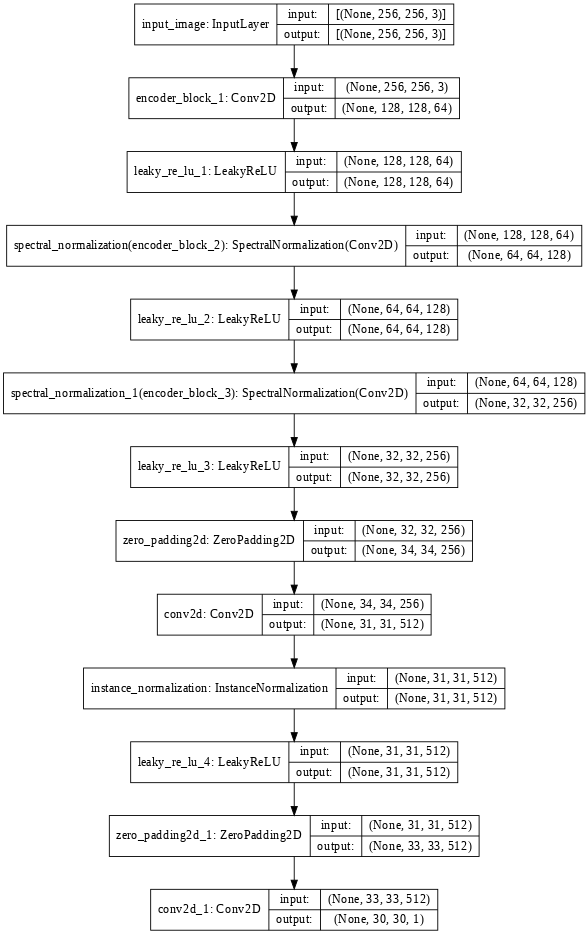

In [15]:
###PatchGAN Discriminator

def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    inp = layers.Input(shape=[256, 256, 3], name='input_image')

    x = inp
    enc_1 = encoder_block(x, 64,  4, 2, apply_instancenorm=False, activation=layers.LeakyReLU(0.2), name='block_1')
    enc_2 = encoder_block(enc_1, 128, 4, 2, apply_instancenorm=False,apply_spectral=True, activation=layers.LeakyReLU(0.2), name='block_2') 
    enc_3 = encoder_block(enc_2, 256, 4, 2, apply_instancenorm=False,apply_spectral=True, activation=layers.LeakyReLU(0.2), name='block_3') 

    zero_pad1 = layers.ZeroPadding2D()(enc_3) # (bs, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1,
                         kernel_initializer=initializer,
                         use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)

    leaky_relu = layers.LeakyReLU(0.2)(norm1)

    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = layers.Conv2D(1, 4, strides=1,
                         kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=inp, outputs=last)
tf.keras.utils.plot_model(Discriminator(), show_shapes=True, dpi=64)

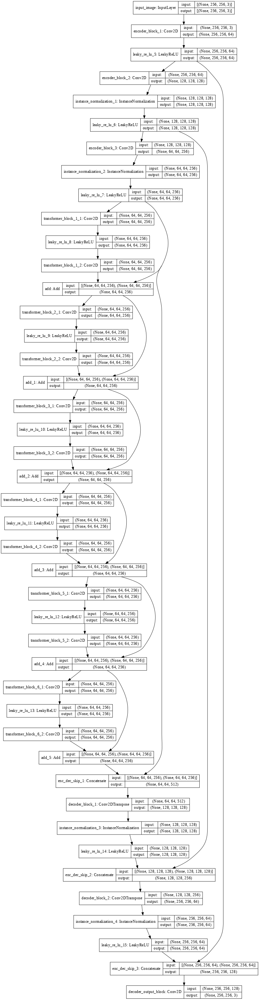

In [16]:
def generator_fn(height=HEIGHT, width=WIDTH, channels=CHANNELS, transformer_blocks=TRANSFORMER_BLOCKS):
    OUTPUT_CHANNELS = 3
    inputs = layers.Input(shape=[height, width, channels], name='input_image')

    # Encoder
    enc_1 = encoder_block(inputs, 64,  7, 1, apply_instancenorm=False, activation=layers.LeakyReLU(0.2), name='block_1') # (bs, 256, 256, 64)
    enc_2 = encoder_block(enc_1, 128, 3, 2, apply_instancenorm=True,apply_spectral=False, activation=layers.LeakyReLU(0.2), name='block_2')   # (bs, 128, 128, 128)
    enc_3 = encoder_block(enc_2, 256, 3, 2, apply_instancenorm=True,apply_spectral=False, activation=layers.LeakyReLU(0.2), name='block_3')   # (bs, 64, 64, 256)
    
    # Transformer
    x = enc_3
    for n in range(transformer_blocks):
        x = transformer_block(x, 3, 1, name=f'block_{n+1}') # (bs, 64, 64, 256)

    # Decoder
    x_skip = layers.Concatenate(name='enc_dec_skip_1')([x, enc_3]) # encoder - decoder skip connection
    
    dec_1 = decoder_block(x_skip, 128, 3, 2, apply_instancenorm=True,apply_spectral=False, name='block_1') # (bs, 128, 128, 128)
    x_skip = layers.Concatenate(name='enc_dec_skip_2')([dec_1, enc_2]) # encoder - decoder skip connection
    
    dec_2 = decoder_block(x_skip, 64,  3, 2, apply_instancenorm=True,apply_spectral=False, name='block_2') # (bs, 256, 256, 64)
    x_skip = layers.Concatenate(name='enc_dec_skip_3')([dec_2, enc_1]) # encoder - decoder skip connection

    outputs = last = layers.Conv2D(OUTPUT_CHANNELS, 7, 
                              strides=1, padding='same', 
                              kernel_initializer=conv_initializer, 
                              use_bias=False, 
                              activation='tanh', 
                              name='decoder_output_block')(x_skip) # (bs, 256, 256, 3)

    generator = keras.Model(inputs, outputs)
    
    return generator

sample_generator = generator_fn()

tf.keras.utils.plot_model(sample_generator, show_shapes=True, dpi=64)



In [46]:
with strategy.scope():
    comics_generator = generator_fn(height=None, width=None, transformer_blocks=TRANSFORMER_BLOCKS) 
    faces_generator = generator_fn(height=None, width=None, transformer_blocks=TRANSFORMER_BLOCKS)

    comics_discriminator = Discriminator() # differentiates real Comics and generated Comic
    faces_discriminator = Discriminator() # differentiates real photos and generated photos

## CycleGan

In [47]:
class CycleGan(keras.Model):
    def __init__(
        self,
        comics_generator,
        faces_generator,
        comics_discriminator,
        faces_discriminator,
        lambda_cycle=10,
    ):
        super(CycleGan, self).__init__()
        self.m_gen = comics_generator
        self.p_gen = faces_generator
        self.m_disc = comics_discriminator
        self.p_disc = faces_discriminator
        self.lambda_cycle = lambda_cycle
        
    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn
    ):
        super(CycleGan, self).compile()
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        
    def train_step(self, batch_data):
        real_comic, real_face = batch_data
        
        with tf.GradientTape(persistent=True) as tape:
            # Face to Comic back to Face
            fake_comic = self.m_gen(real_face, training=True)
            cycled_face = self.p_gen(fake_comic, training=True)

            # Comic to Face back to Comic
            fake_face = self.p_gen(real_comic, training=True)
            cycled_comic = self.m_gen(fake_face, training=True)

            # generating itself
            same_comic = self.m_gen(real_comic, training=True)
            same_face = self.p_gen(real_face, training=True)

            # discriminator used to check, inputing real images
            disc_real_comic = self.m_disc(real_comic, training=True)
            disc_real_face = self.p_disc(real_face, training=True)

            # discriminator used to check, inputing fake images
            disc_fake_comic = self.m_disc(fake_comic, training=True)
            disc_fake_face = self.p_disc(fake_face, training=True)

            # evaluates generator loss
            comic_gen_loss = self.gen_loss_fn(disc_fake_comic)
            face_gen_loss = self.gen_loss_fn(disc_fake_face)

            # evaluates total cycle consistency loss
            total_cycle_loss = self.cycle_loss_fn(real_comic, cycled_comic, self.lambda_cycle) + self.cycle_loss_fn(real_face, cycled_face, self.lambda_cycle)

            # evaluates total generator loss
            total_comic_gen_loss = comic_gen_loss + total_cycle_loss + self.identity_loss_fn(real_comic, same_comic, self.lambda_cycle)
            total_face_gen_loss = face_gen_loss + total_cycle_loss + self.identity_loss_fn(real_face, same_face, self.lambda_cycle)

            # evaluates discriminator loss
            comic_disc_loss = self.disc_loss_fn(disc_real_comic, disc_fake_comic)
            face_disc_loss = self.disc_loss_fn(disc_real_face, disc_fake_face)

        # Calculate the gradients for generator and discriminator
        comic_generator_gradients = tape.gradient(total_comic_gen_loss,
                                                  self.m_gen.trainable_variables)
        face_generator_gradients = tape.gradient(total_face_gen_loss,
                                                  self.p_gen.trainable_variables)

        comic_discriminator_gradients = tape.gradient(comic_disc_loss,
                                                      self.m_disc.trainable_variables)
        face_discriminator_gradients = tape.gradient(face_disc_loss,
                                                      self.p_disc.trainable_variables)

        # Apply the gradients to the optimizer
        self.m_gen_optimizer.apply_gradients(zip(comic_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(face_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(comic_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(face_discriminator_gradients,
                                                  self.p_disc.trainable_variables))
        
        return {
            "comic_gen_loss": total_comic_gen_loss,
            "face_gen_loss": total_face_gen_loss,
            "comic_disc_loss": comic_disc_loss,
            "face_disc_loss": face_disc_loss
        }


## Loss Def

In [48]:
####Discriminator Loss with label smoothing

with strategy.scope():
    def discriminator_loss(real, generated):
        real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE,label_smoothing=LABEL_SMOOTHING)(tf.ones_like(real), real)

        generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE,label_smoothing=LABEL_SMOOTHING)(tf.zeros_like(generated), generated)

        total_disc_loss = real_loss + generated_loss

        return total_disc_loss * 0.5

####Generator Loss

with strategy.scope():
    def generator_loss(generated):
        return tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(generated), generated)

####Cycle Loss

with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):
        loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))

        return LAMBDA * loss1

#### Identity Loss

with strategy.scope():
    def identity_loss(real_image, same_image, LAMBDA):
        loss = tf.reduce_mean(tf.abs(real_image - same_image))
        return LAMBDA * 0.5 * loss

#### Optimizer

with strategy.scope():
    comic_generator_optimizer = tf.keras.optimizers.Adam(GENERATOR_LR, beta_1=0.5)
    face_generator_optimizer = tf.keras.optimizers.Adam(GENERATOR_LR, beta_1=0.5)

    comic_discriminator_optimizer = tf.keras.optimizers.Adam(DISCRIMINATOR_LR, beta_1=0.5)
    face_discriminator_optimizer = tf.keras.optimizers.Adam(DISCRIMINATOR_LR, beta_1=0.5)

## Create Model

In [49]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        comics_generator, faces_generator, comics_discriminator, faces_discriminator
    )

    cycle_gan_model.compile(
        m_gen_optimizer = comic_generator_optimizer,
        p_gen_optimizer = face_generator_optimizer,
        m_disc_optimizer = comic_discriminator_optimizer,
        p_disc_optimizer = face_discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss
    )


## Aux Function

In [50]:
def generate_images(model, test_input,epoch,save_path = ''):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(20,20))

    display_list = [test_input[0], prediction[0]]

    title = ['Input Image', 'Predicted Image']
    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    if save_path != '':
        plt.savefig(f'{save_path}/{epoch}.jpg', bbox_inches='tight')
        

    plt.show()

## Custom CalLBack

In [51]:
from tensorflow.keras.callbacks import Callback
class GANMonitor(Callback):
    def __init__(self, num_img=1,save_every_epoch=4,watch_every_epoch=2,save_dir='./'):
        self.num_img = num_img
        self.save_every_epoch = save_every_epoch
        self.watch_every_epoch = watch_every_epoch
        self.save_dir = save_dir

    def on_epoch_end(self, epoch, logs=None):
        # Generate Image every second epoch
        if epoch % self.watch_every_epoch == 0:
            for example_input, example_target in test_ds.take(self.num_img): #Generate Comic from Photo
                generate_images(comics_generator, example_target,epoch,save_path = '/content/drive/Shareddrives/Google Drive Unlimited/ImageGIF')
            for example_input, example_target in test_ds.take(self.num_img): #Generate Photo from Comic
                generate_images(faces_generator, example_input,epoch,save_path='')
        if (epoch > 0) & (epoch % self.save_every_epoch == 0):
            #Save Generator
            comics_generator.save(f"{self.save_dir}/AnimeGenTrain_{epoch}.h5",save_format='h5',overwrite=True)
            faces_generator.save(f"{self.save_dir}/FaceGenTrain_{epoch}.h5",save_format='h5',overwrite=True)
    
            

# Model Training

In [52]:
STEP=len(train_comics_paths)//BATCH_SIZE
print(STEP)

309


In [53]:
# custom_save = '/content/drive/Shareddrives/Google Drive Unlimited/ComicOnNewArch'

Epoch 1/100
  6/309 [..............................] - ETA: 3:44 - comic_gen_loss: 12.3464 - face_gen_loss: 11.9823 - comic_disc_loss: 0.6801 - face_disc_loss: 0.6828WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0027s vs `on_train_batch_end` time: 11.5967s). Check your callbacks.


309/309 [==============================] - 399s 1s/step - comic_gen_loss: 4.0336 - face_gen_loss: 4.1602 - comic_disc_loss: 0.5537 - face_disc_loss: 0.5618


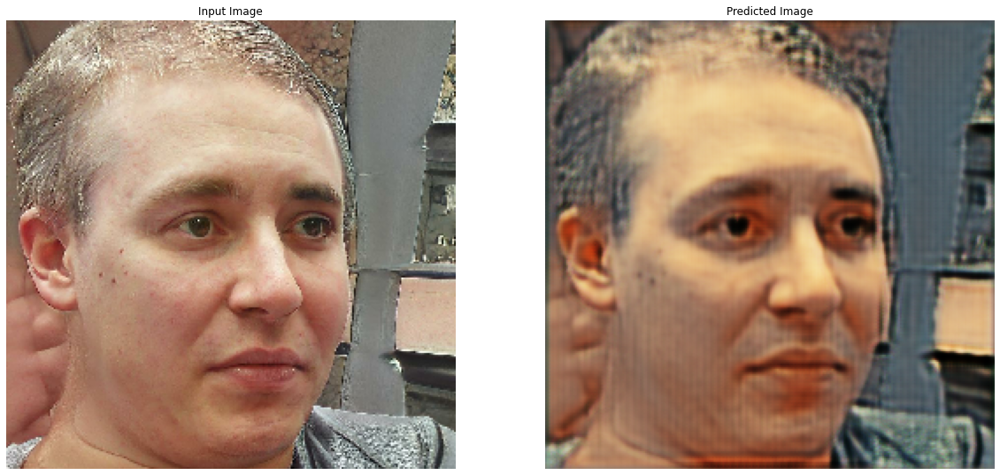

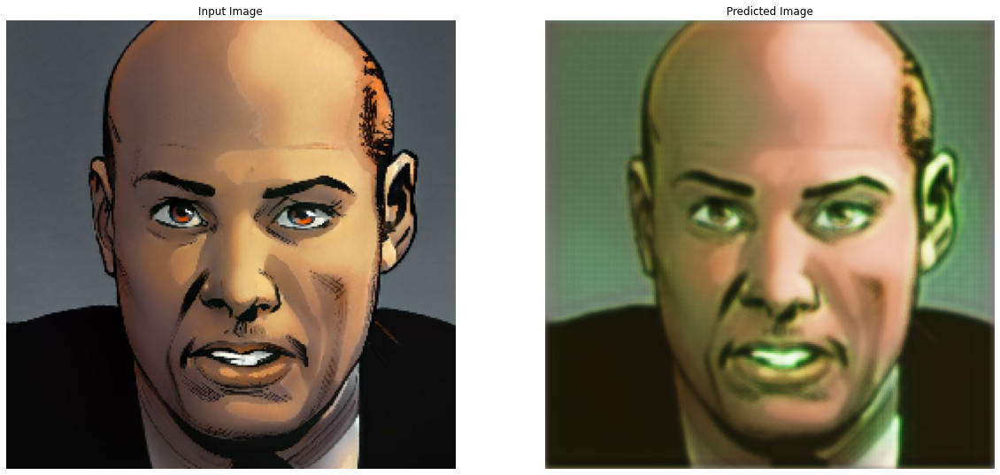

Epoch 2/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.3466 - face_gen_loss: 3.5158 - comic_disc_loss: 0.6122 - face_disc_loss: 0.5934
Epoch 3/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.1720 - face_gen_loss: 3.2735 - comic_disc_loss: 0.5646 - face_disc_loss: 0.5985
Epoch 4/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.0397 - face_gen_loss: 2.9840 - comic_disc_loss: 0.5500 - face_disc_loss: 0.6041
Epoch 5/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.8963 - face_gen_loss: 3.0128 - comic_disc_loss: 0.5834 - face_disc_loss: 0.5664
Epoch 6/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.1247 - face_gen_loss: 3.0042 - comic_disc_loss: 0.5196 - face_disc_loss: 0.5319


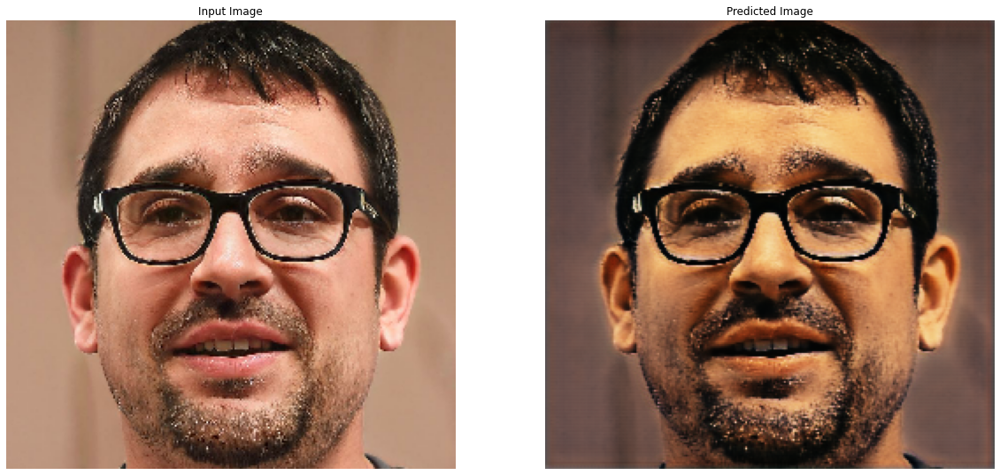

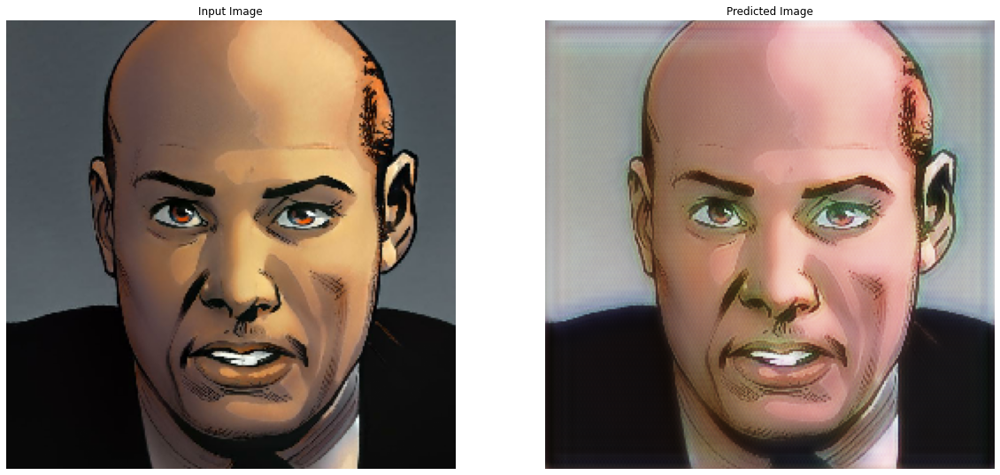

Epoch 7/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.7488 - face_gen_loss: 3.0273 - comic_disc_loss: 0.5799 - face_disc_loss: 0.5207
Epoch 8/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.5336 - face_gen_loss: 3.0422 - comic_disc_loss: 0.3853 - face_disc_loss: 0.5695
Epoch 9/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.8066 - face_gen_loss: 2.9676 - comic_disc_loss: 0.6066 - face_disc_loss: 0.5145
Epoch 10/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 3.1201 - face_gen_loss: 3.1295 - comic_disc_loss: 0.4981 - face_disc_loss: 0.5266
Epoch 11/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.9852 - face_gen_loss: 2.8955 - comic_disc_loss: 0.5201 - face_disc_loss: 0.5359


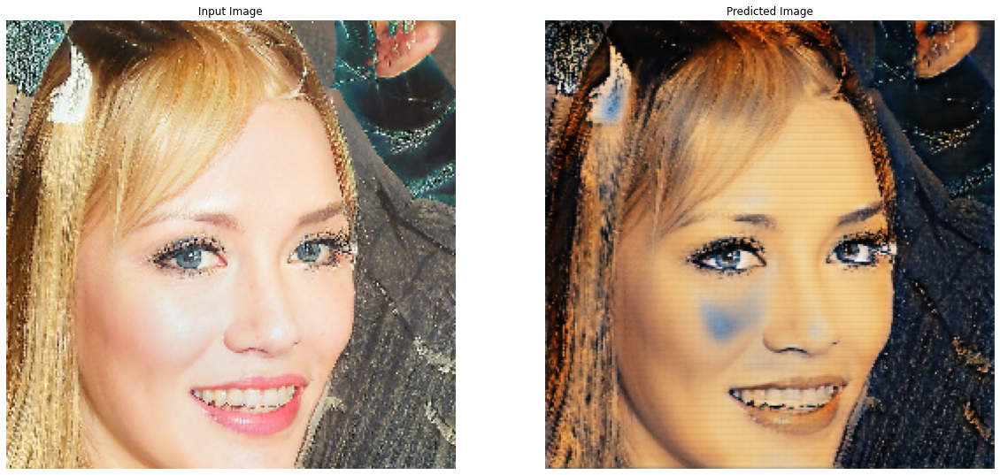

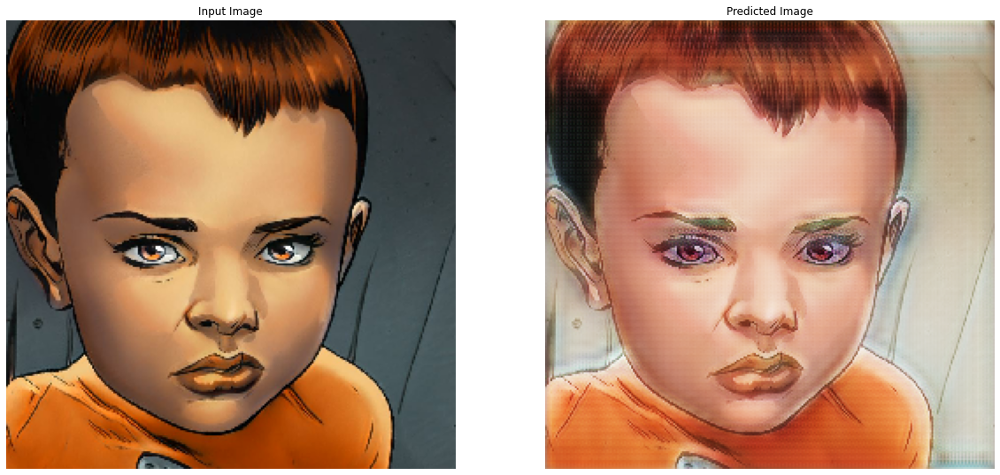

Epoch 12/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2745 - face_gen_loss: 2.1692 - comic_disc_loss: 0.6327 - face_disc_loss: 0.6843
Epoch 13/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.7054 - face_gen_loss: 2.4951 - comic_disc_loss: 0.5551 - face_disc_loss: 0.5959
Epoch 14/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0973 - face_gen_loss: 2.6578 - comic_disc_loss: 0.6834 - face_disc_loss: 0.5287
Epoch 15/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.0749 - face_gen_loss: 2.5211 - comic_disc_loss: 0.6686 - face_disc_loss: 0.5782
Epoch 16/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.6007 - face_gen_loss: 3.0428 - comic_disc_loss: 0.5961 - face_disc_loss: 0.4672


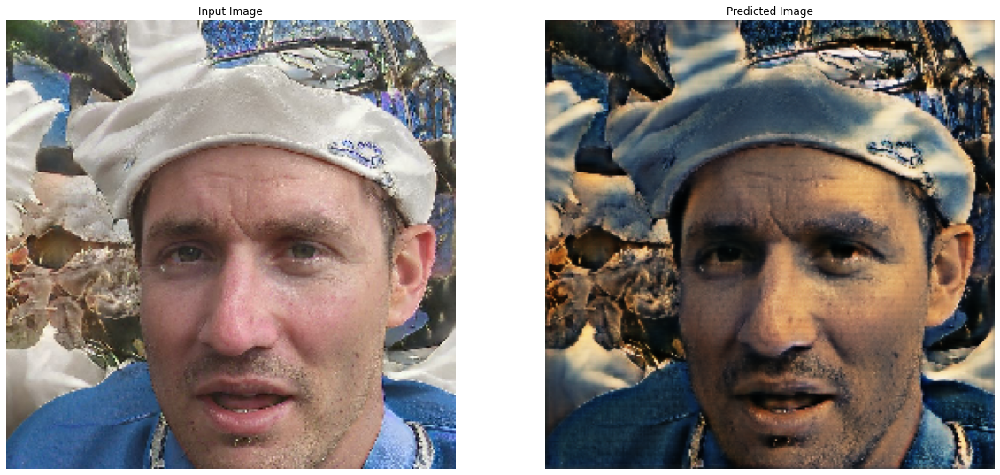

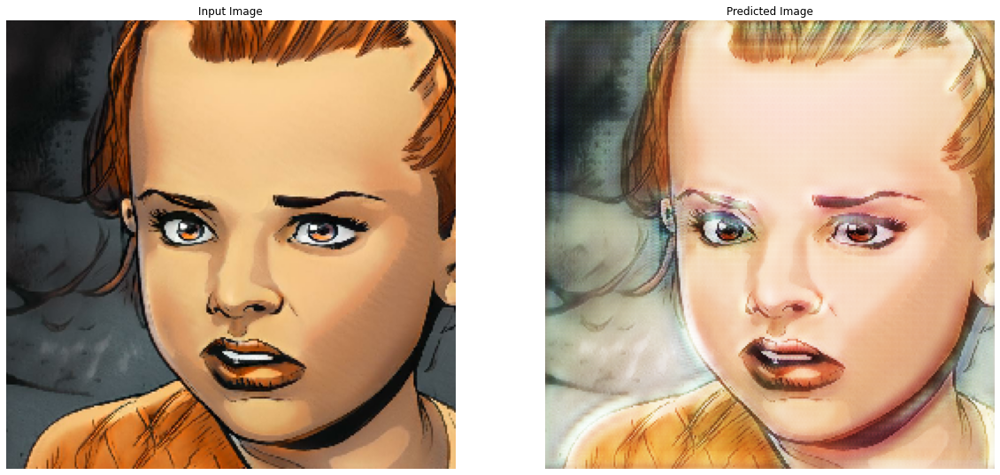

Epoch 17/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5339 - face_gen_loss: 3.0229 - comic_disc_loss: 0.6140 - face_disc_loss: 0.4829
Epoch 18/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.9696 - face_gen_loss: 3.2184 - comic_disc_loss: 0.5255 - face_disc_loss: 0.4570
Epoch 19/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.9361 - face_gen_loss: 2.4176 - comic_disc_loss: 0.4819 - face_disc_loss: 0.6702
Epoch 20/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.9632 - face_gen_loss: 2.7985 - comic_disc_loss: 0.5171 - face_disc_loss: 0.5916
Epoch 21/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.2764 - face_gen_loss: 2.8115 - comic_disc_loss: 0.4573 - face_disc_loss: 0.5932


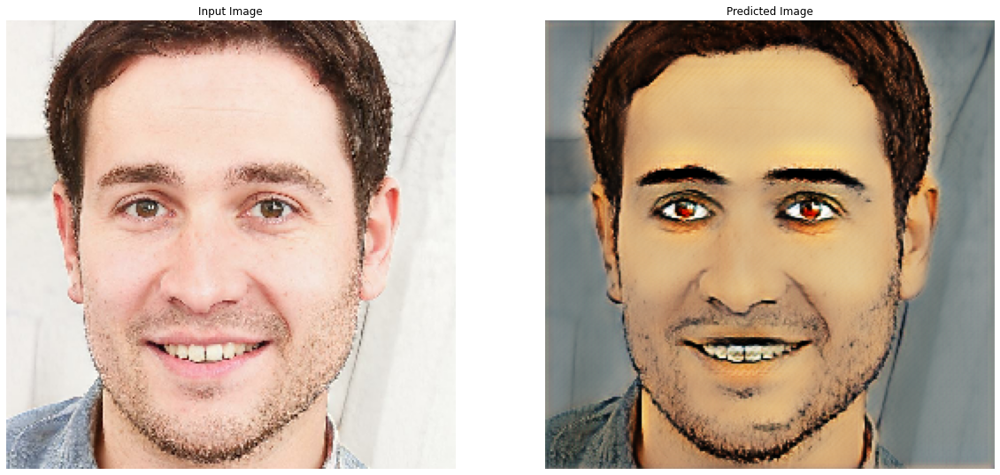

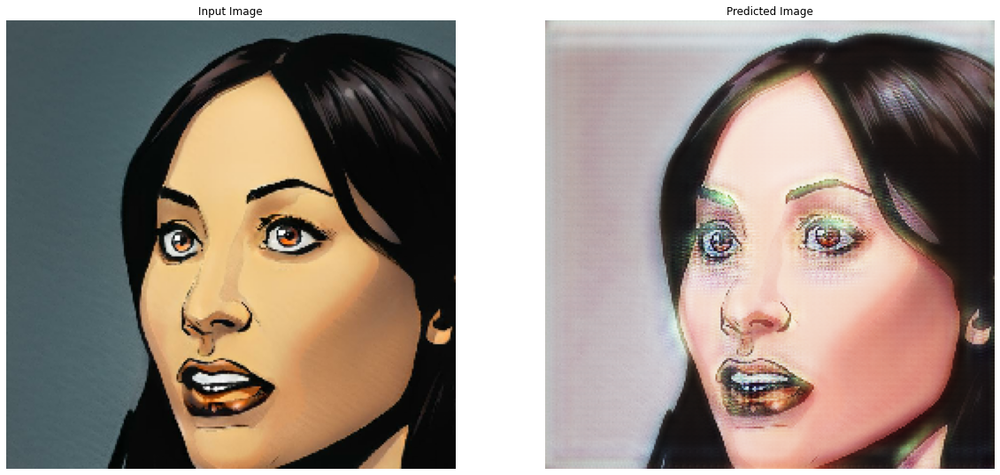

Epoch 22/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.4980 - face_gen_loss: 2.9157 - comic_disc_loss: 0.6403 - face_disc_loss: 0.5000
Epoch 23/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.8424 - face_gen_loss: 2.7930 - comic_disc_loss: 0.5372 - face_disc_loss: 0.5833
Epoch 24/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.2538 - face_gen_loss: 3.0196 - comic_disc_loss: 0.4864 - face_disc_loss: 0.5280
Epoch 25/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.1238 - face_gen_loss: 2.4764 - comic_disc_loss: 0.6642 - face_disc_loss: 0.6064
Epoch 26/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5938 - face_gen_loss: 2.8386 - comic_disc_loss: 0.5837 - face_disc_loss: 0.5304


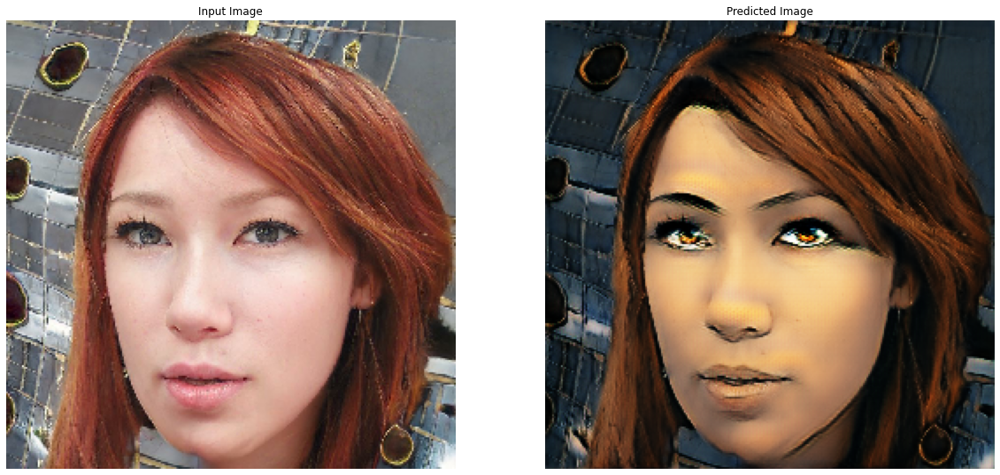

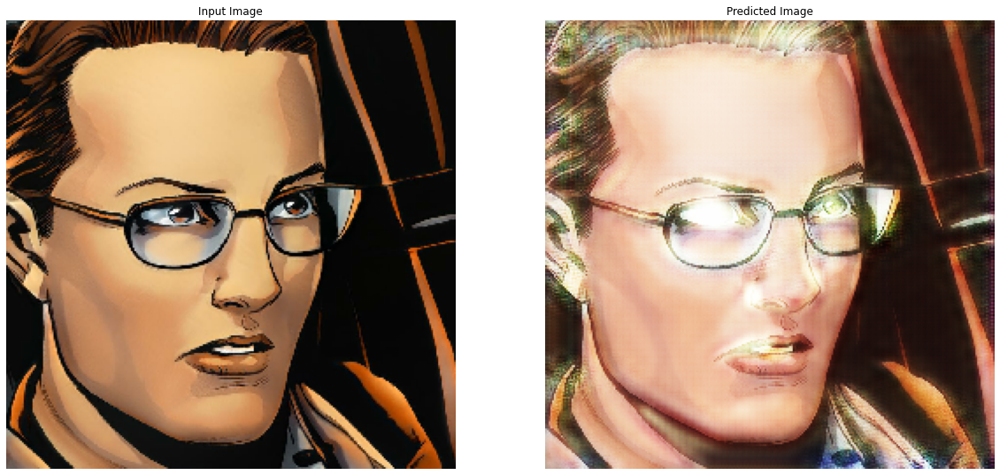

Epoch 27/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.6771 - face_gen_loss: 2.6756 - comic_disc_loss: 0.5598 - face_disc_loss: 0.5902
Epoch 28/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.6987 - face_gen_loss: 2.6931 - comic_disc_loss: 0.5625 - face_disc_loss: 0.5602
Epoch 29/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1960 - face_gen_loss: 2.7927 - comic_disc_loss: 0.6777 - face_disc_loss: 0.5066
Epoch 30/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5977 - face_gen_loss: 2.9103 - comic_disc_loss: 0.5735 - face_disc_loss: 0.4913
Epoch 31/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.8522 - face_gen_loss: 2.7299 - comic_disc_loss: 0.5057 - face_disc_loss: 0.5868


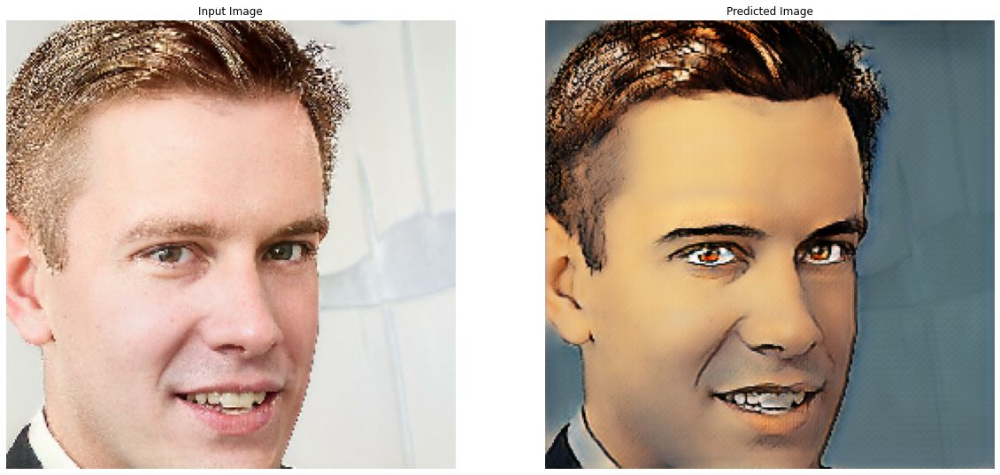

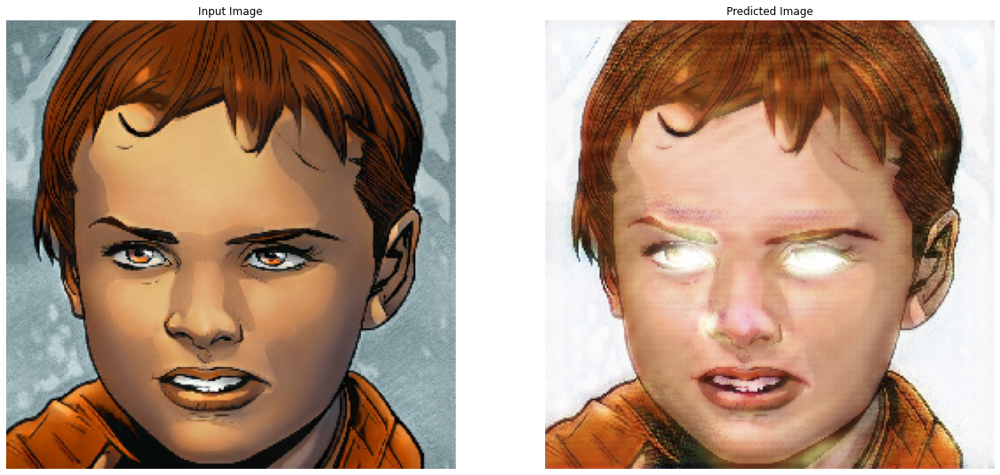

Epoch 32/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.5768 - face_gen_loss: 2.4381 - comic_disc_loss: 0.5812 - face_disc_loss: 0.6496
Epoch 33/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.8695 - face_gen_loss: 2.6879 - comic_disc_loss: 0.5044 - face_disc_loss: 0.6025
Epoch 34/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.5157 - face_gen_loss: 2.6390 - comic_disc_loss: 0.5955 - face_disc_loss: 0.5552
Epoch 35/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5953 - face_gen_loss: 2.8387 - comic_disc_loss: 0.5968 - face_disc_loss: 0.5073
Epoch 36/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.7810 - face_gen_loss: 2.5251 - comic_disc_loss: 0.5142 - face_disc_loss: 0.6188


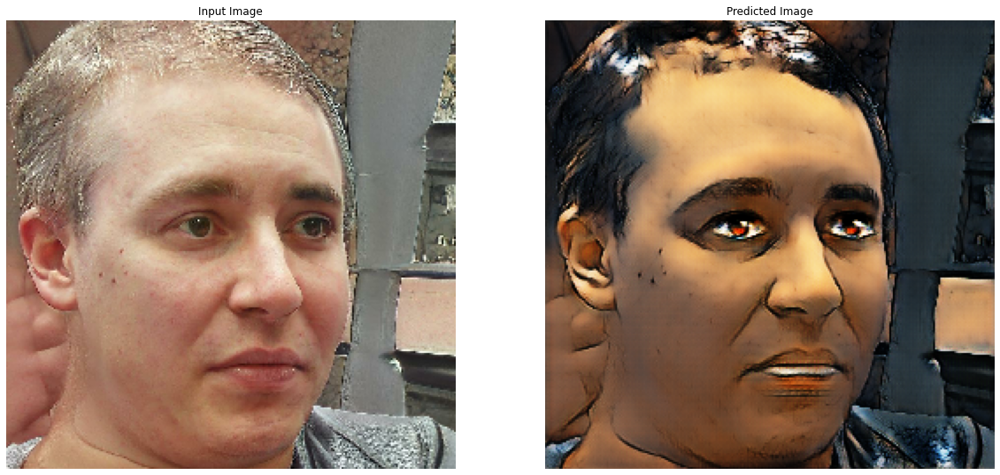

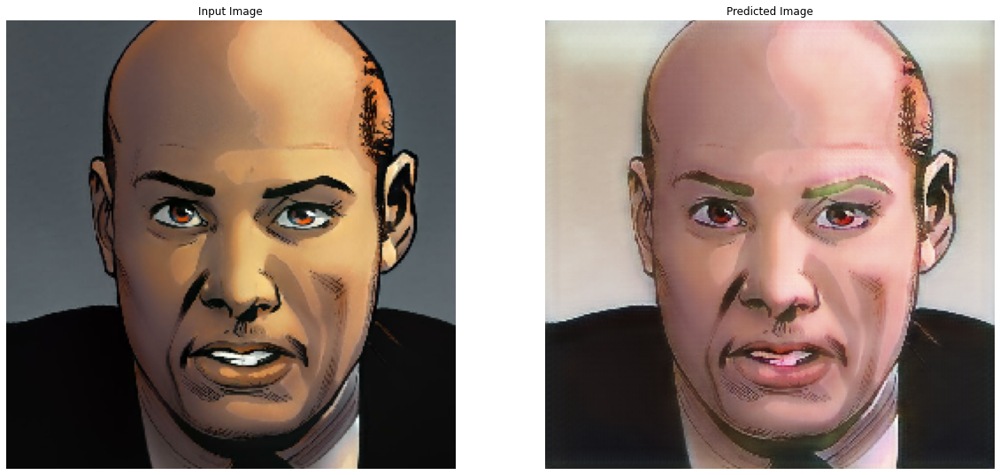

Epoch 37/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.3346 - face_gen_loss: 2.1260 - comic_disc_loss: 0.6145 - face_disc_loss: 0.6706
Epoch 38/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2034 - face_gen_loss: 2.3948 - comic_disc_loss: 0.6553 - face_disc_loss: 0.6190
Epoch 39/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.9494 - face_gen_loss: 2.3728 - comic_disc_loss: 0.6779 - face_disc_loss: 0.5874
Epoch 40/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0321 - face_gen_loss: 2.0767 - comic_disc_loss: 0.6470 - face_disc_loss: 0.6565
Epoch 41/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2457 - face_gen_loss: 2.4921 - comic_disc_loss: 0.6360 - face_disc_loss: 0.5668


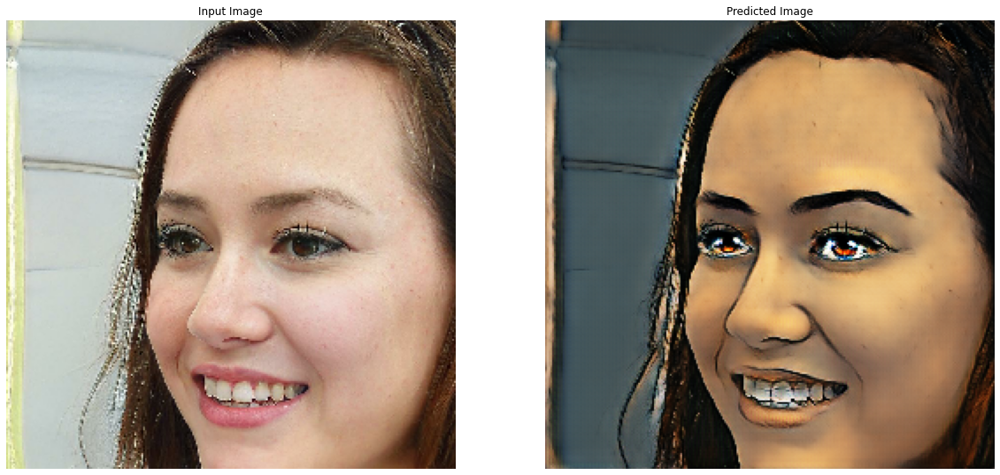

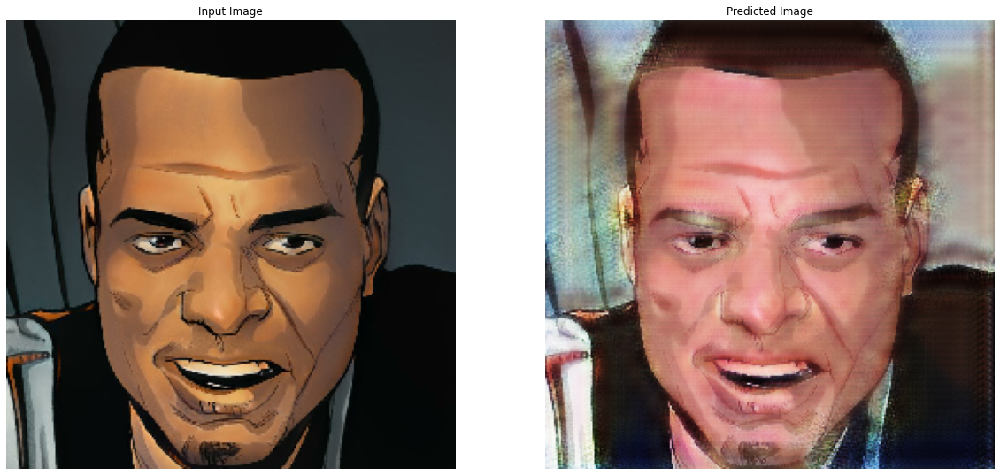

Epoch 42/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.4168 - face_gen_loss: 2.3183 - comic_disc_loss: 0.5765 - face_disc_loss: 0.6350
Epoch 43/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.4632 - face_gen_loss: 2.1321 - comic_disc_loss: 0.5462 - face_disc_loss: 0.6844
Epoch 44/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.7658 - face_gen_loss: 2.6558 - comic_disc_loss: 0.5458 - face_disc_loss: 0.6078
Epoch 45/100
309/309 [==============================] - 229s 740ms/step - comic_gen_loss: 2.5935 - face_gen_loss: 2.3537 - comic_disc_loss: 0.5381 - face_disc_loss: 0.6483
Epoch 46/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5523 - face_gen_loss: 2.2053 - comic_disc_loss: 0.5369 - face_disc_loss: 0.6619


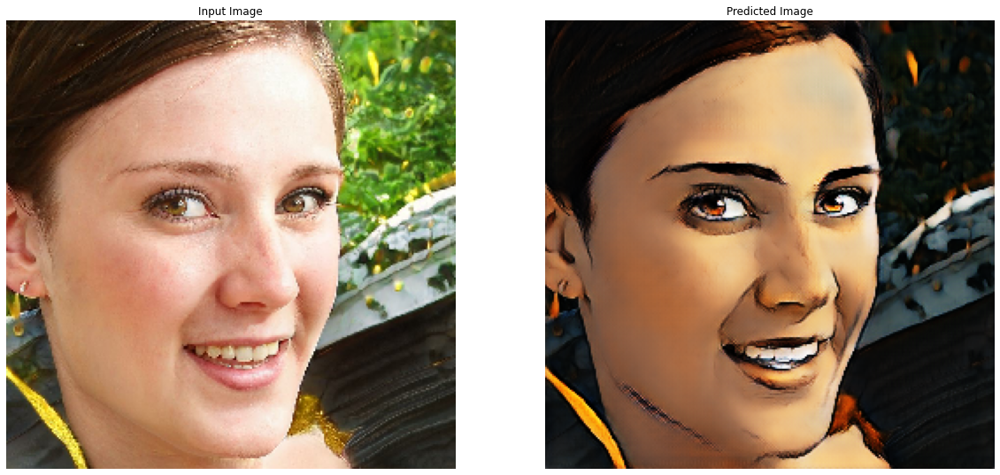

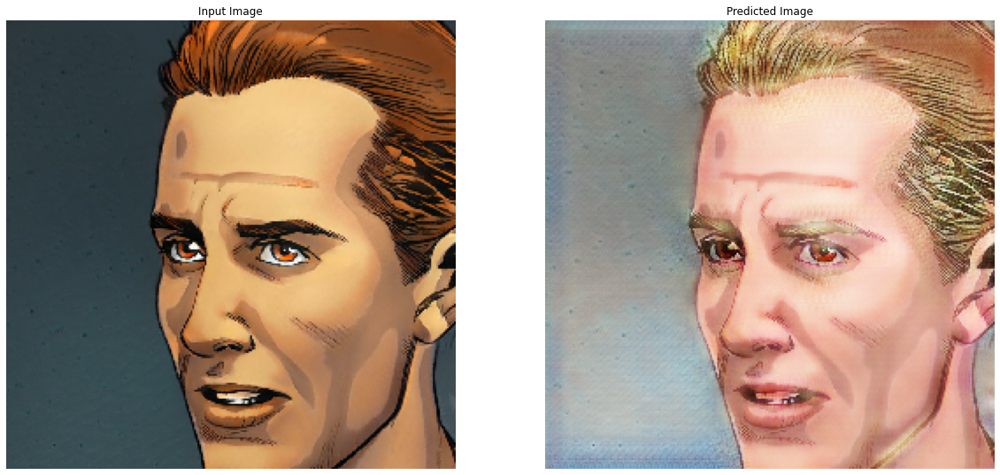

Epoch 47/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0187 - face_gen_loss: 2.2418 - comic_disc_loss: 0.6920 - face_disc_loss: 0.6179
Epoch 48/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0681 - face_gen_loss: 2.2466 - comic_disc_loss: 0.6431 - face_disc_loss: 0.6203
Epoch 49/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2353 - face_gen_loss: 2.4648 - comic_disc_loss: 0.6272 - face_disc_loss: 0.5491
Epoch 50/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2089 - face_gen_loss: 2.0898 - comic_disc_loss: 0.5995 - face_disc_loss: 0.6787
Epoch 51/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2808 - face_gen_loss: 2.0546 - comic_disc_loss: 0.5806 - face_disc_loss: 0.6750


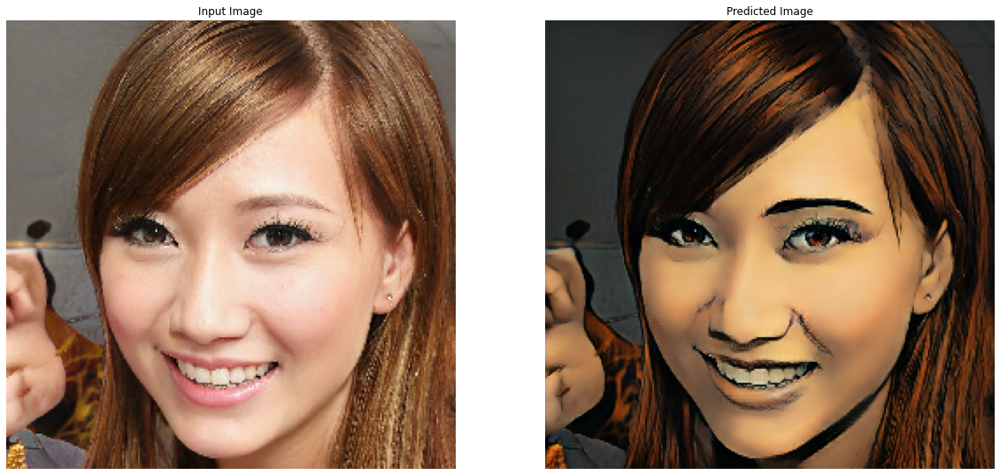

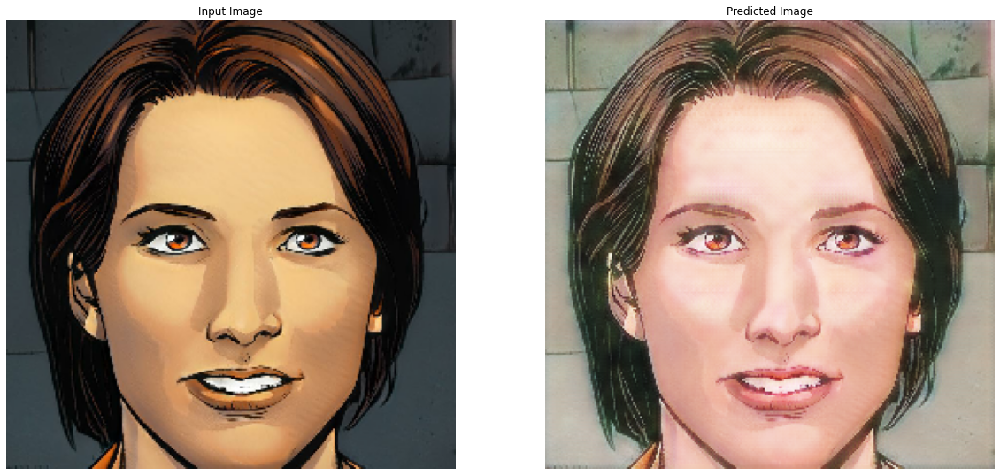

Epoch 52/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.2778 - face_gen_loss: 2.7636 - comic_disc_loss: 0.4753 - face_disc_loss: 0.5767
Epoch 53/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.5189 - face_gen_loss: 2.2368 - comic_disc_loss: 0.5654 - face_disc_loss: 0.6623
Epoch 54/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.4142 - face_gen_loss: 2.0008 - comic_disc_loss: 0.5746 - face_disc_loss: 0.6834
Epoch 55/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.9488 - face_gen_loss: 1.9214 - comic_disc_loss: 0.6602 - face_disc_loss: 0.6726
Epoch 56/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7502 - face_gen_loss: 1.8169 - comic_disc_loss: 0.6916 - face_disc_loss: 0.6770


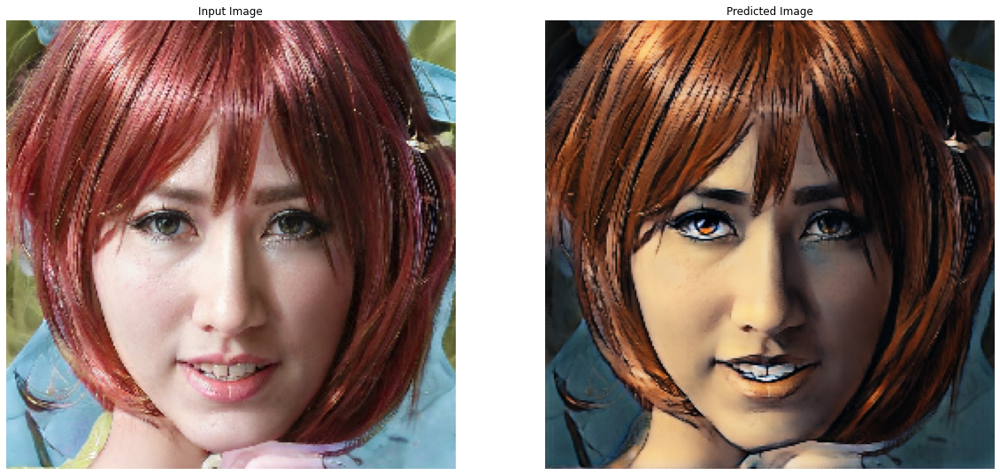

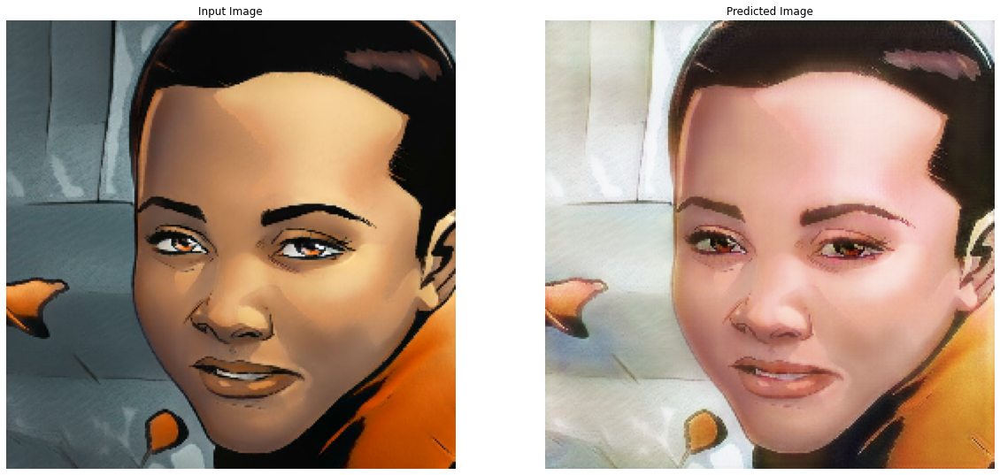

Epoch 57/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7895 - face_gen_loss: 1.8401 - comic_disc_loss: 0.6831 - face_disc_loss: 0.6777
Epoch 58/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.0925 - face_gen_loss: 2.0244 - comic_disc_loss: 0.6232 - face_disc_loss: 0.6715
Epoch 59/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0821 - face_gen_loss: 2.1127 - comic_disc_loss: 0.6380 - face_disc_loss: 0.6438
Epoch 60/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2267 - face_gen_loss: 2.2635 - comic_disc_loss: 0.6145 - face_disc_loss: 0.6234
Epoch 61/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.3398 - face_gen_loss: 2.2235 - comic_disc_loss: 0.5701 - face_disc_loss: 0.6189


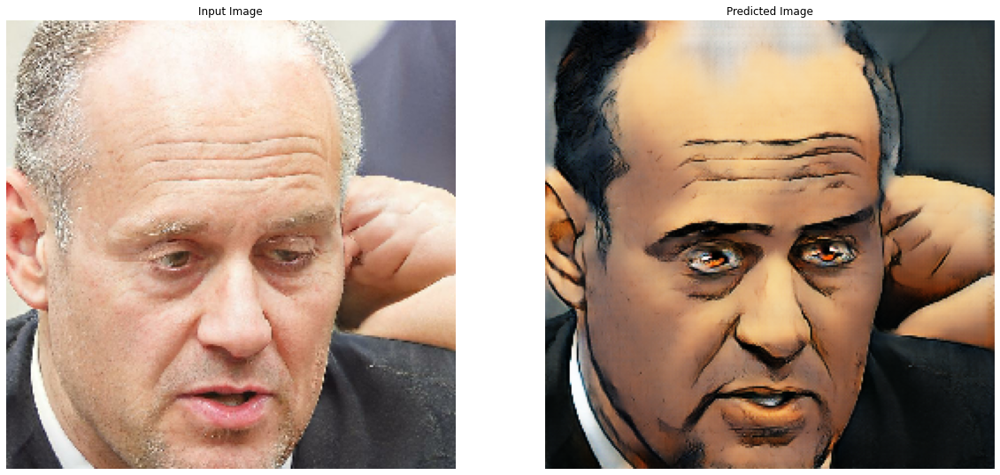

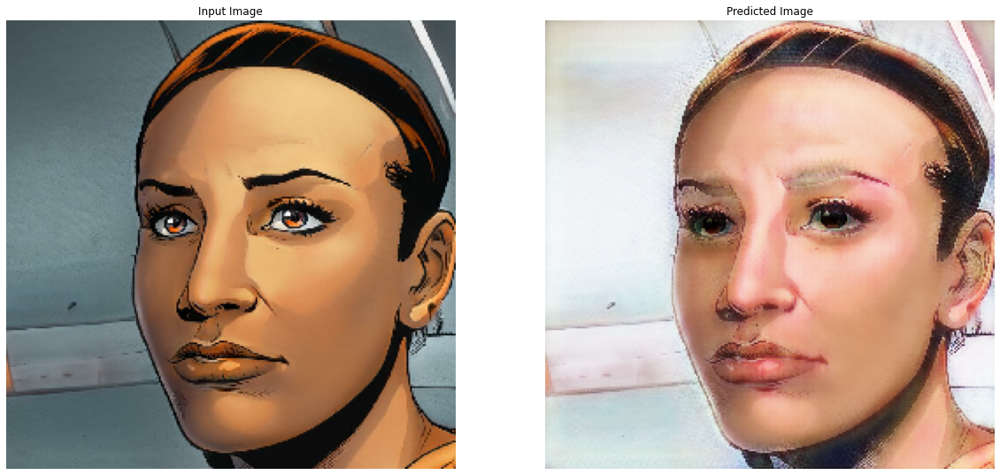

Epoch 62/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2592 - face_gen_loss: 2.0964 - comic_disc_loss: 0.5937 - face_disc_loss: 0.6474
Epoch 63/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.4335 - face_gen_loss: 2.2985 - comic_disc_loss: 0.5516 - face_disc_loss: 0.6028
Epoch 64/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.3321 - face_gen_loss: 2.0777 - comic_disc_loss: 0.5869 - face_disc_loss: 0.6756
Epoch 65/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7660 - face_gen_loss: 2.0707 - comic_disc_loss: 0.6903 - face_disc_loss: 0.6123
Epoch 66/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.6744 - face_gen_loss: 1.8403 - comic_disc_loss: 0.6862 - face_disc_loss: 0.6630


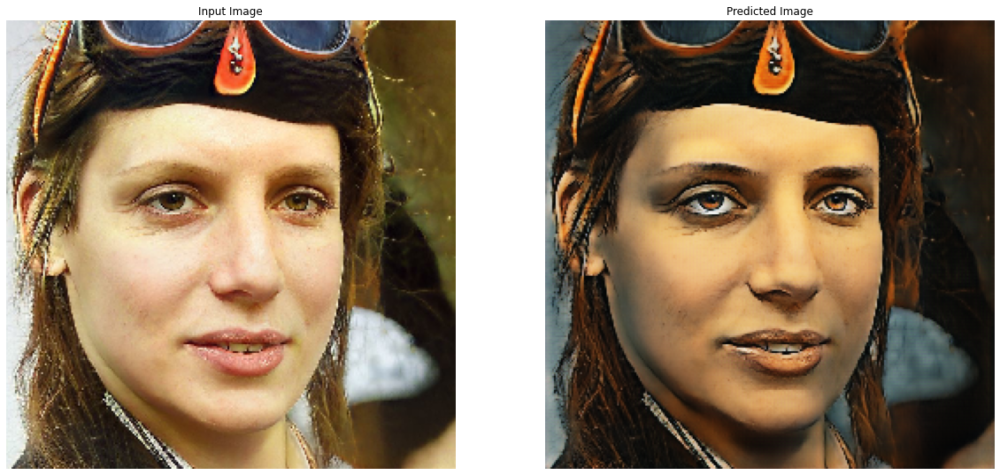

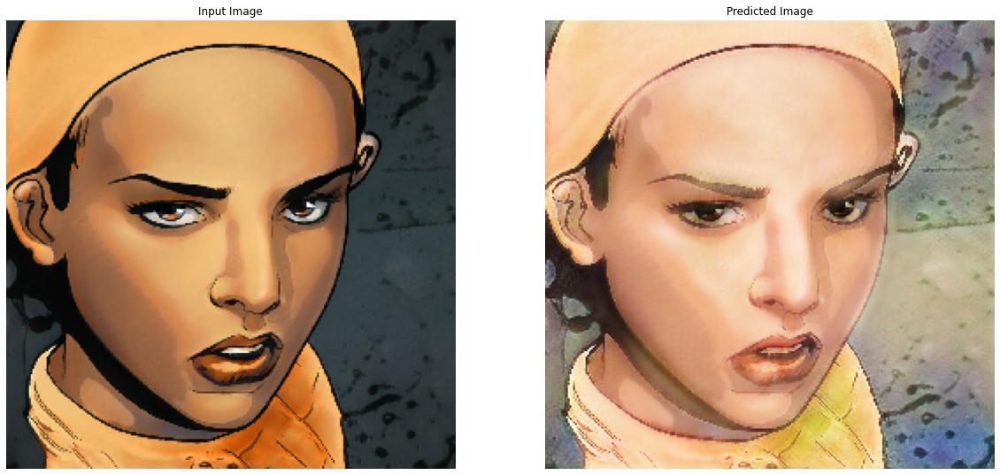

Epoch 67/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.6902 - face_gen_loss: 1.8319 - comic_disc_loss: 0.6821 - face_disc_loss: 0.6582
Epoch 68/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7464 - face_gen_loss: 1.9241 - comic_disc_loss: 0.6807 - face_disc_loss: 0.6334
Epoch 69/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7579 - face_gen_loss: 1.8004 - comic_disc_loss: 0.6678 - face_disc_loss: 0.6709
Epoch 70/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.8344 - face_gen_loss: 2.1091 - comic_disc_loss: 0.6789 - face_disc_loss: 0.5908
Epoch 71/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.6512 - face_gen_loss: 1.8878 - comic_disc_loss: 0.6918 - face_disc_loss: 0.6417


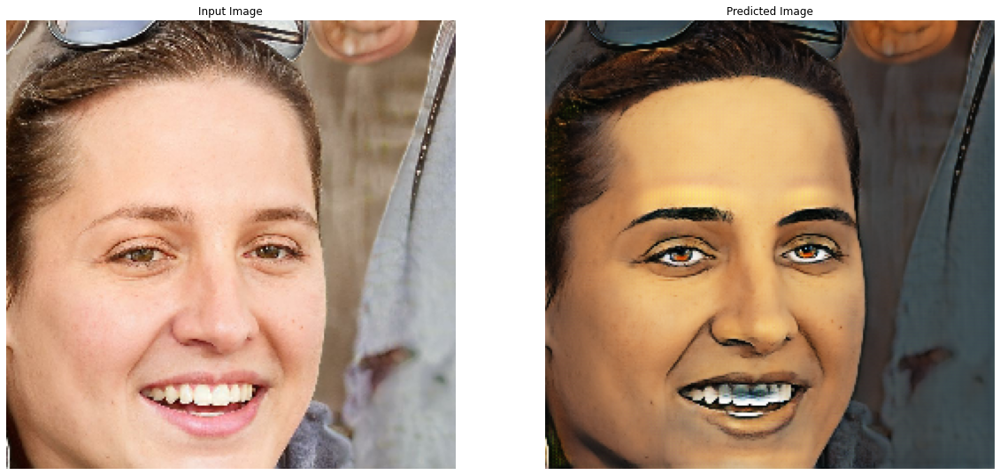

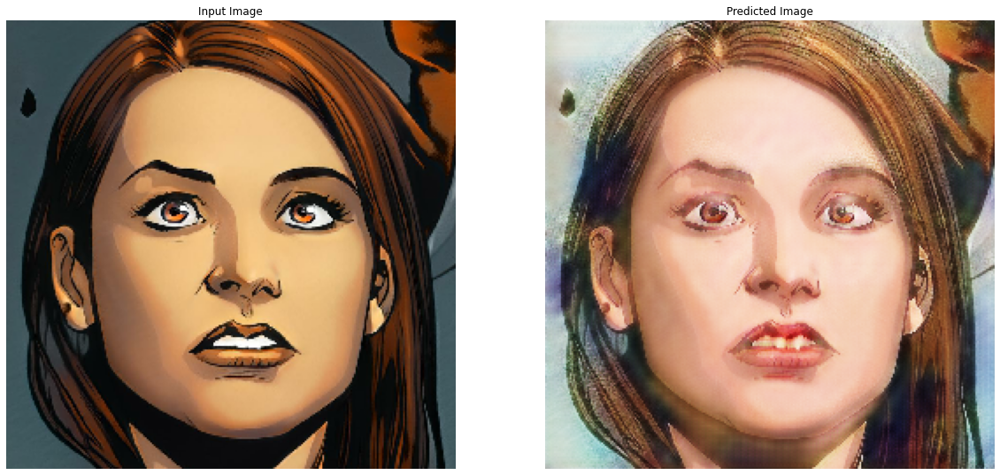

Epoch 72/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.7572 - face_gen_loss: 2.0112 - comic_disc_loss: 0.6777 - face_disc_loss: 0.6072
Epoch 73/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.6773 - face_gen_loss: 1.7041 - comic_disc_loss: 0.6766 - face_disc_loss: 0.6771
Epoch 74/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2266 - face_gen_loss: 2.2691 - comic_disc_loss: 0.6439 - face_disc_loss: 0.6530
Epoch 75/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.6161 - face_gen_loss: 2.3736 - comic_disc_loss: 0.5457 - face_disc_loss: 0.6057
Epoch 76/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2043 - face_gen_loss: 2.2179 - comic_disc_loss: 0.6312 - face_disc_loss: 0.6103


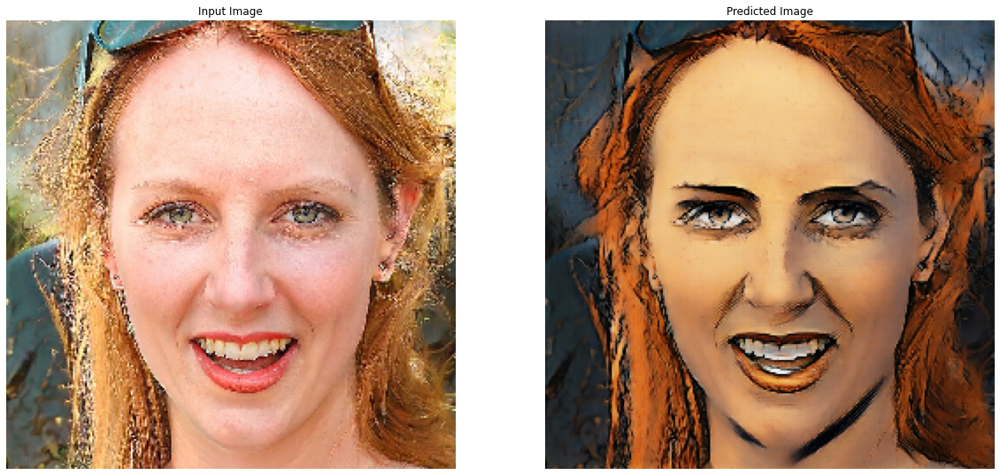

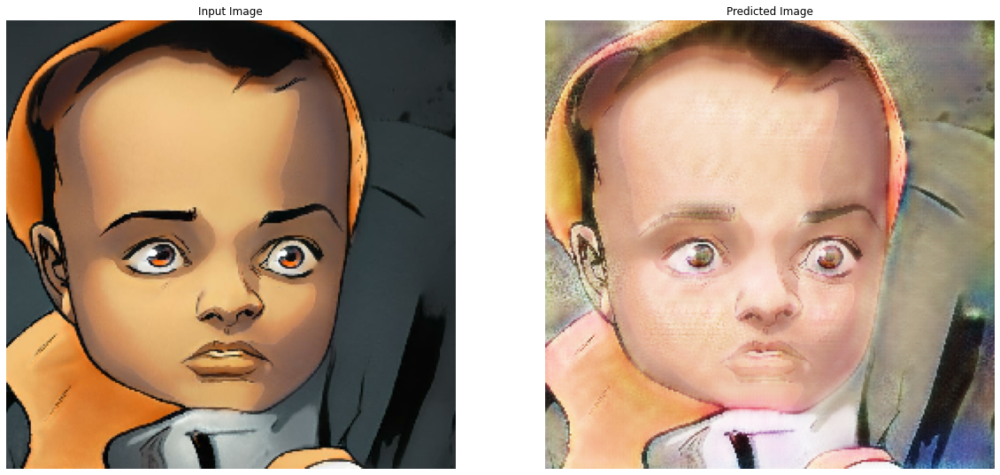

Epoch 77/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0515 - face_gen_loss: 1.8582 - comic_disc_loss: 0.6062 - face_disc_loss: 0.6840
Epoch 78/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1077 - face_gen_loss: 2.0922 - comic_disc_loss: 0.6177 - face_disc_loss: 0.6274
Epoch 79/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.8109 - face_gen_loss: 2.1188 - comic_disc_loss: 0.6808 - face_disc_loss: 0.5823
Epoch 80/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 1.7799 - face_gen_loss: 1.7437 - comic_disc_loss: 0.6620 - face_disc_loss: 0.6878
Epoch 81/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.9096 - face_gen_loss: 1.9413 - comic_disc_loss: 0.6472 - face_disc_loss: 0.6441


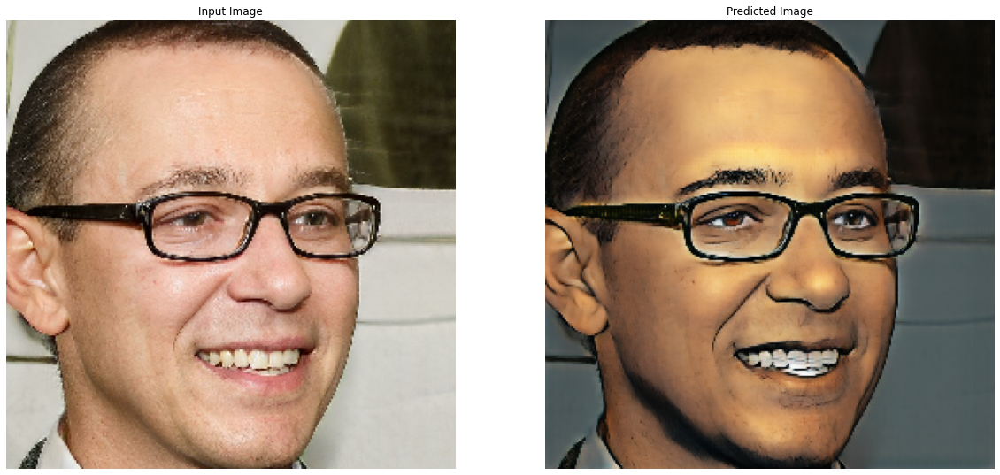

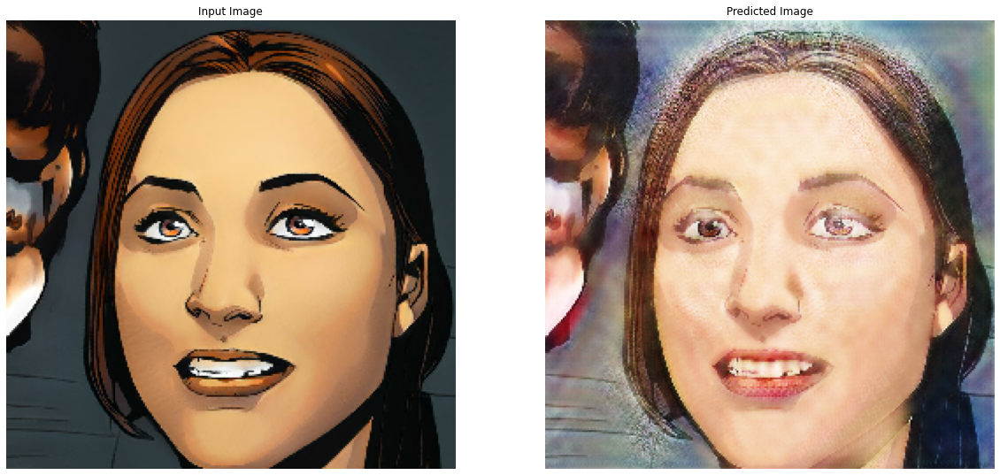

Epoch 82/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.8322 - face_gen_loss: 1.7787 - comic_disc_loss: 0.6391 - face_disc_loss: 0.6894
Epoch 83/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.9227 - face_gen_loss: 1.8624 - comic_disc_loss: 0.6333 - face_disc_loss: 0.6830
Epoch 84/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.8324 - face_gen_loss: 1.7565 - comic_disc_loss: 0.6503 - face_disc_loss: 0.6745
Epoch 85/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.8316 - face_gen_loss: 1.8202 - comic_disc_loss: 0.6449 - face_disc_loss: 0.6674
Epoch 86/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0532 - face_gen_loss: 1.9314 - comic_disc_loss: 0.6018 - face_disc_loss: 0.6640


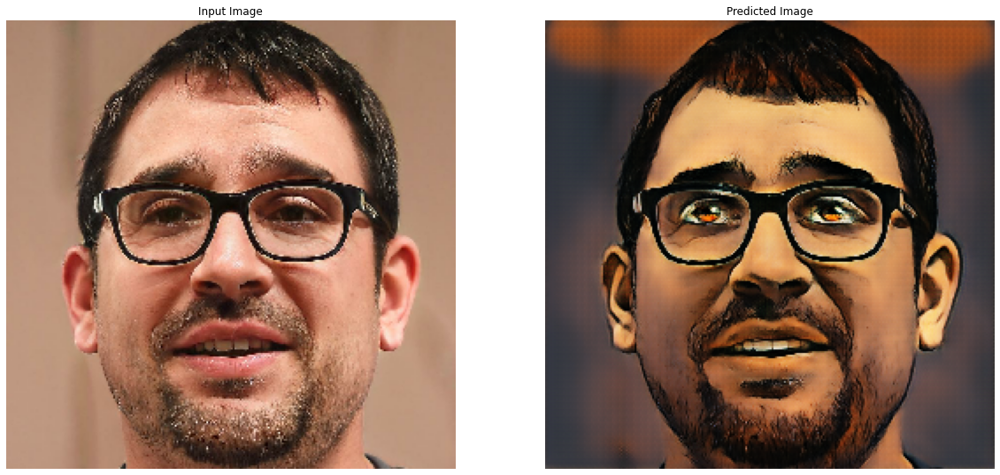

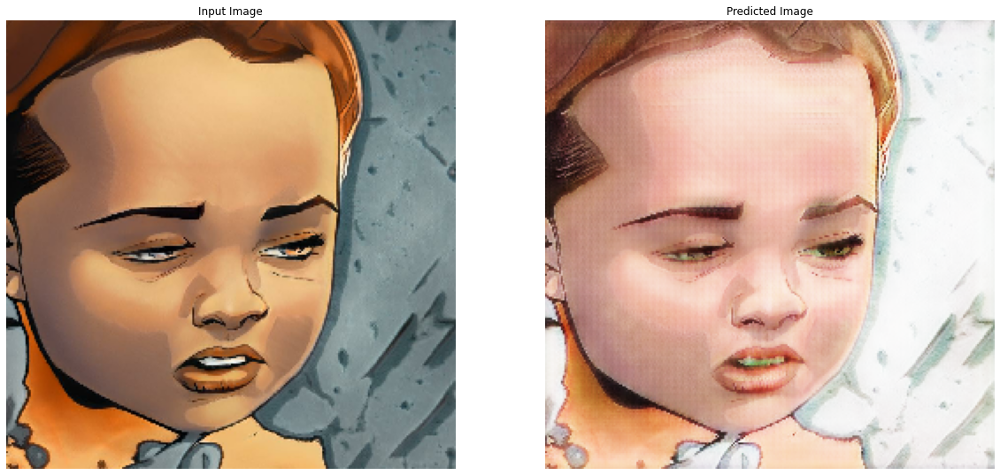

Epoch 87/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1135 - face_gen_loss: 2.1476 - comic_disc_loss: 0.6075 - face_disc_loss: 0.6053
Epoch 88/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 3.2517 - face_gen_loss: 2.4541 - comic_disc_loss: 0.4390 - face_disc_loss: 0.6322
Epoch 89/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.2394 - face_gen_loss: 2.2024 - comic_disc_loss: 0.5948 - face_disc_loss: 0.5966
Epoch 90/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1733 - face_gen_loss: 2.4034 - comic_disc_loss: 0.6520 - face_disc_loss: 0.5541
Epoch 91/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1074 - face_gen_loss: 2.0056 - comic_disc_loss: 0.5978 - face_disc_loss: 0.6524


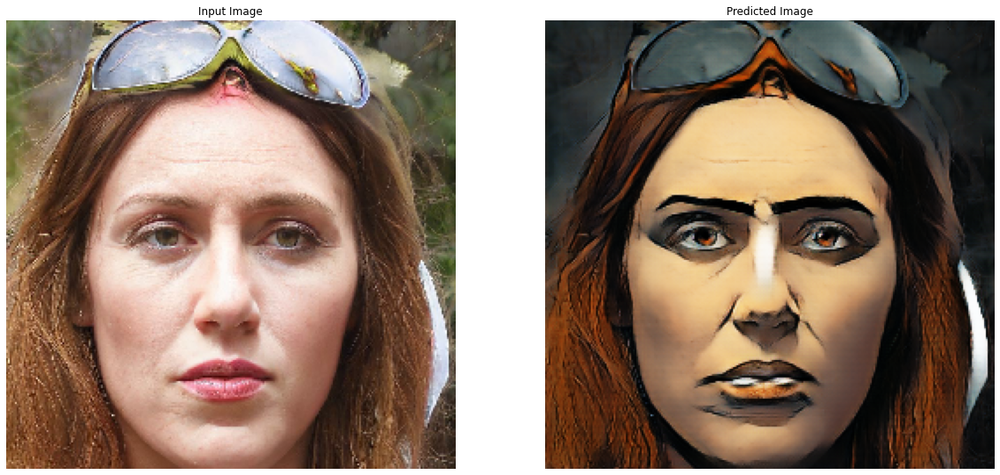

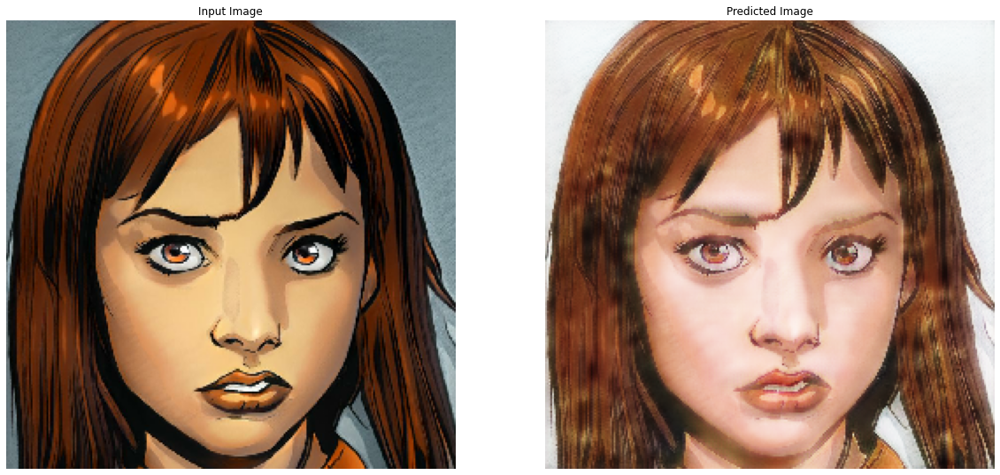

Epoch 92/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.1470 - face_gen_loss: 1.8915 - comic_disc_loss: 0.5748 - face_disc_loss: 0.6765
Epoch 93/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.0765 - face_gen_loss: 1.8537 - comic_disc_loss: 0.6119 - face_disc_loss: 0.6912
Epoch 94/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 1.6059 - face_gen_loss: 1.7247 - comic_disc_loss: 0.6881 - face_disc_loss: 0.6724
Epoch 95/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 1.6547 - face_gen_loss: 1.6902 - comic_disc_loss: 0.6771 - face_disc_loss: 0.6817
Epoch 96/100
309/309 [==============================] - 229s 742ms/step - comic_gen_loss: 2.0238 - face_gen_loss: 1.8965 - comic_disc_loss: 0.6105 - face_disc_loss: 0.6716


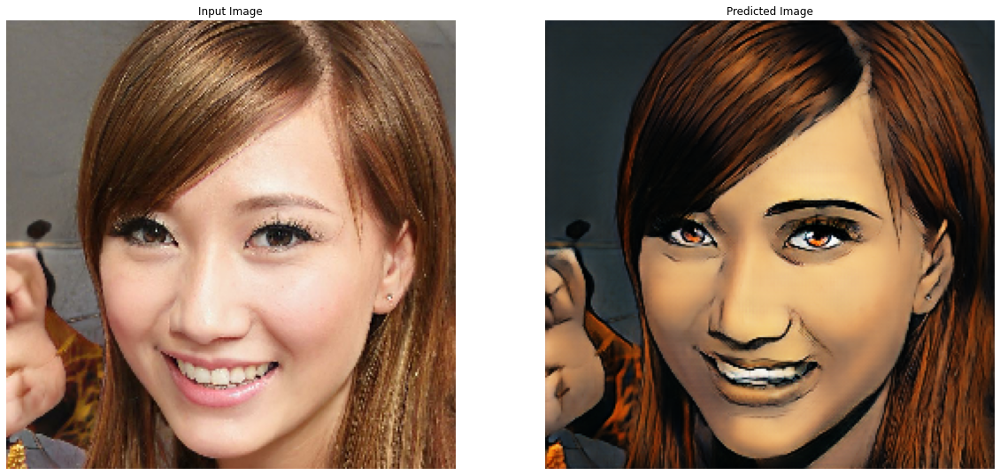

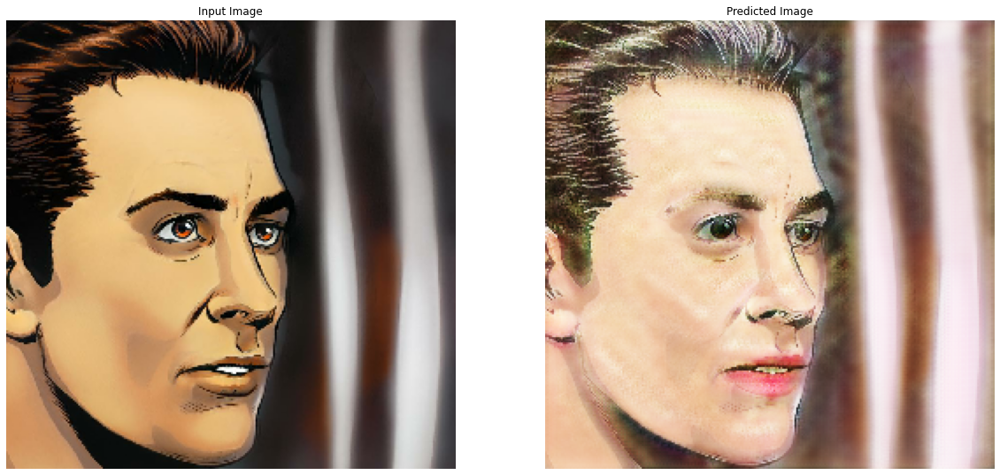

Epoch 97/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.7974 - face_gen_loss: 2.4399 - comic_disc_loss: 0.5325 - face_disc_loss: 0.5820
Epoch 98/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1938 - face_gen_loss: 2.0901 - comic_disc_loss: 0.6064 - face_disc_loss: 0.6265
Epoch 99/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 1.9327 - face_gen_loss: 1.8873 - comic_disc_loss: 0.6328 - face_disc_loss: 0.6600
Epoch 100/100
309/309 [==============================] - 229s 741ms/step - comic_gen_loss: 2.1211 - face_gen_loss: 1.8816 - comic_disc_loss: 0.5783 - face_disc_loss: 0.6835


In [54]:
history = cycle_gan_model.fit(
        train_ds,
        epochs=100,verbose=True,callbacks=[GANMonitor(save_every_epoch=10,watch_every_epoch=5)],steps_per_epoch=STEP,initial_epoch=0
    )


First 50 Epoch

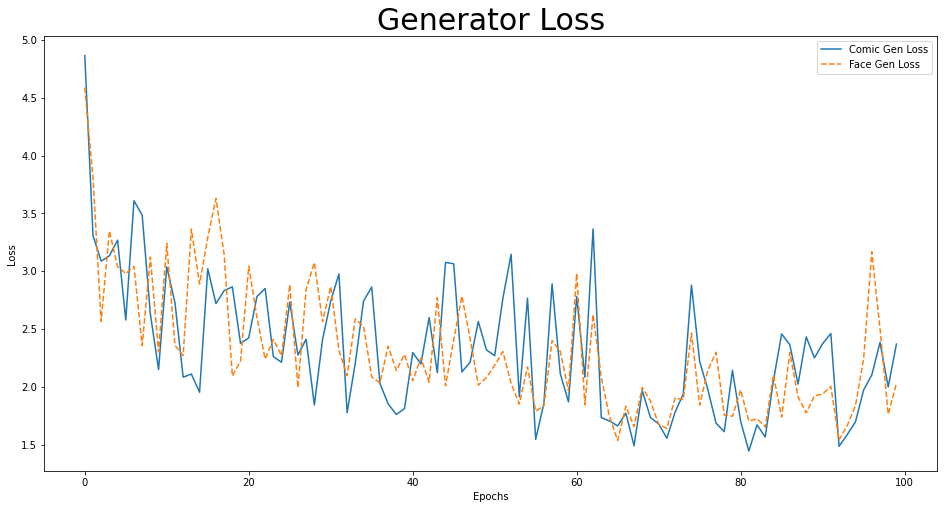

In [74]:
plt.figure(figsize = (16,8))
plt.plot(history.epoch,[np.mean(x) for x in history.history['comic_gen_loss'] ],label='Comic Gen Loss')
plt.plot(history.epoch,[np.mean(x) for x in history.history['face_gen_loss'] ],label='Face Gen Loss',linestyle='--')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Generator Loss',size=30)

plt.show()



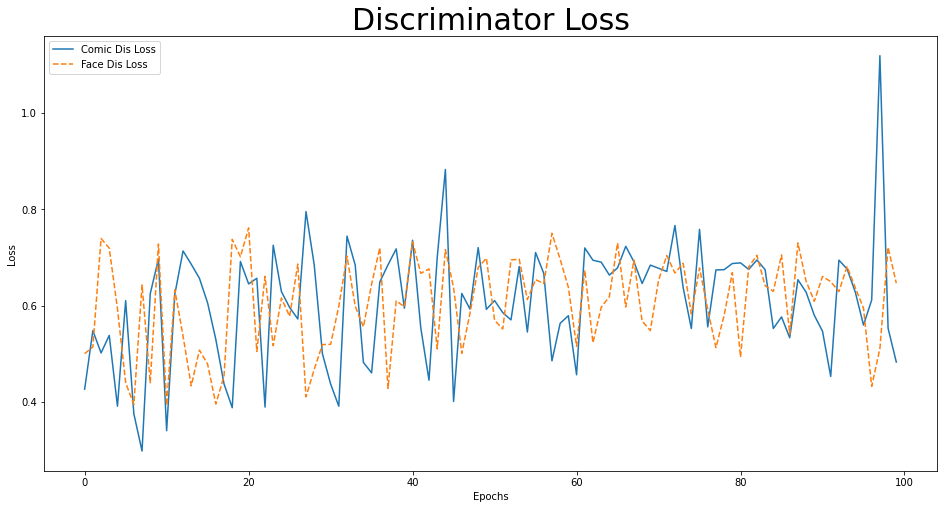

In [75]:
plt.figure(figsize = (16,8))
plt.plot(history.epoch,[np.mean(x) for x in history.history['comic_disc_loss'] ],label='Comic Dis Loss')
plt.plot(history.epoch,[np.mean(x) for x in history.history['face_disc_loss'] ],label='Face Dis Loss',linestyle='--')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Discriminator Loss',size=30)

plt.show()



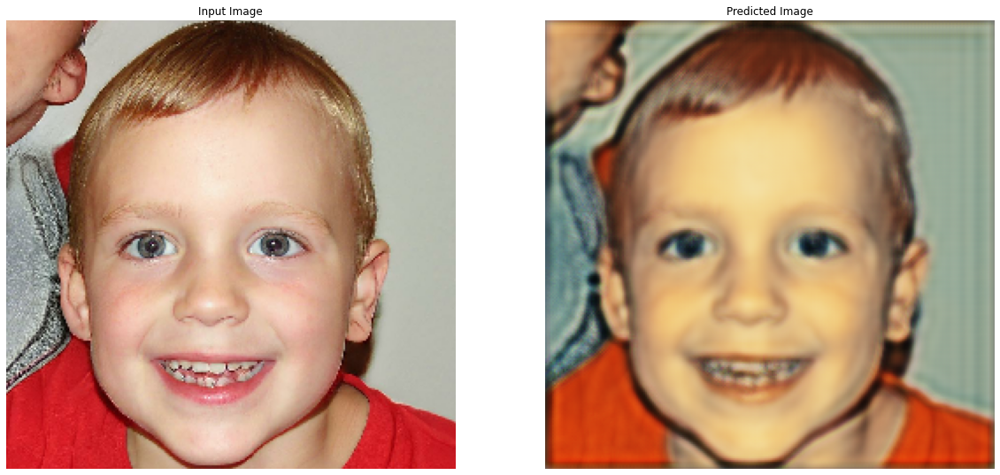

In [42]:
    for example_input, example_target in train_ds.take(1):
        generate_images(comics_generator, example_target,1,save_path = '/content/drive/Shareddrives/Google Drive Unlimited/ImageGIF')

In [ ]:
import os, random, json, PIL, shutil, re, imageio, glob
from PIL import ImageDraw


In [63]:
filenames = glob.glob('/content/drive/Shareddrives/Google Drive Unlimited/ImageGIF/*')

In [73]:
import imageio
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('movie.gif', images,fps=1)